<a href="https://colab.research.google.com/github/ritwikraha/Talks-and-Lessons/blob/main/workshops/inpainting_workshop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Image Inpainting through the lens of GenAI ✨

This workshop/tutorial is mostly inspired from the following


- [Inpaint Image - AI photo Restoration](https://pyimagesearch.com/2024/03/11/understanding-tasks-in-diffusers-part-2/)
-  [HuggingFace Documentation](https://huggingface.co/docs/diffusers/en/using-diffusers/inpaint?regular-specific=runwayml%2Fstable-diffusion-v1-5#inpainting)
- [Image Inpainting with OpenCV and Python](https://pyimagesearch.com/2020/05/18/image-inpainting-with-opencv-and-python/)

### Setup and Imports

In [1]:
!pip install -qq diffusers accelerate

In [35]:
import torch
import numpy as np
import cv2
from matplotlib import pyplot as plt
from PIL import Image
from transformers import pipeline
from transformers import SamModel, SamProcessor
from diffusers import AutoPipelineForText2Image,AutoPipelineForImage2Image, AutoPipelineForInpainting, ControlNetModel, StableDiffusionControlNetInpaintPipeline
from diffusers.utils import load_image, make_image_grid

In [3]:
device = "cuda" if torch.cuda.is_available() else "cpu"
generator = torch.Generator(device).manual_seed(31)

In [4]:
init_image = load_image("https://huggingface.co/datasets/ritwikraha/random-storage/resolve/main/boat.png")
mask_image = load_image("https://huggingface.co/datasets/ritwikraha/random-storage/resolve/main/boat-mask.png")

## Image Inpainting as a Diffusion Problem


**Diffusion Models in a Nutshell:**

Imagine a clear image slowly corrupted by adding noise until it becomes pure static. That's the core idea of diffusion models.

The steps to think of Image Inpainting as a Diffusion problem is quite simple.
We have learned that once a diffusion model is trained its quite good at prediciting the noise residual. We can also condition this process on:
- An initial image
- A text prompt and an image
- A mask of the image area

![img](https://huggingface.co/datasets/ritwikraha/random-storage/resolve/main/diffusers-inpainting.png)


Here's a breakdown of image inpainting with diffusion models:

 They are trained to reverse this process, taking the noisy version (corrupted image) and gradually denoising it to recover the original image.

**Inpainting with Diffusion:**

The challenge is to adapt this process to specifically fill in missing image regions. Here's how it works:

1. **Mask Definition:** You define a mask that marks the region requiring inpainting. This can be a simple rectangle, a free-form shape, or even a specific object cutout.

2. **Conditioning the Diffusion Process:**
    * **Latent Space:** The original image is encoded into a latent space representation. This compressed version captures the image's essence.
    * **Mask Integration:** The mask information is incorporated during the denoising steps. This can be achieved through various techniques:
        * **Masked Denoising:** The model only focuses on denoising within the masked region, considering the surrounding unmasked area as a reference. ([https://arxiv.org/abs/2201.09865](https://arxiv.org/abs/2201.09865))
        * **Guiding with Additional Information:** Some methods allow incorporating textual descriptions or even object masks to steer the inpainting process towards a specific outcome. ([https://arxiv.org/abs/2212.05034](https://arxiv.org/abs/2212.05034))

3. **Image Reconstruction:** Throughout the denoising steps, the diffusion model leverages the mask information to prioritize filling the masked region with content that coheres with the surrounding image.

**Challenges and Advancements:**

* **Exact conditioning:** Directly incorporating the mask information into the denoising process is mathematically complex. Researchers are exploring methods like Tractable Probabilistic Models (TPMs) to achieve more precise control over the inpainting procedure. ([https://arxiv.org/abs/2401.03349](https://arxiv.org/abs/2401.03349))

**Resources:**

* **Hugging Face - Stable Diffusion Inpainting:** [https://huggingface.co/spaces/multimodalart/stable-diffusion-inpainting](https://huggingface.co/spaces/multimodalart/stable-diffusion-inpainting) (Provides code and information on using a pre-trained model for inpainting)
* **SmartBrush: Text and Shape Guided Object Inpainting with Diffusion Model:** [https://arxiv.org/abs/2212.05034](https://arxiv.org/abs/2212.05034) (Research paper proposing a method for incorporating text and object masks for guided inpainting)



### A Simple Inpainting Pipeline

In [47]:
model_id = "kandinsky-community/kandinsky-2-2-decoder-inpaint"

pipeline = AutoPipelineForInpainting.from_pretrained(
    model_id, torch_dtype=torch.float16
).to(device)

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [48]:
prompt = "a small photorealistic island"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

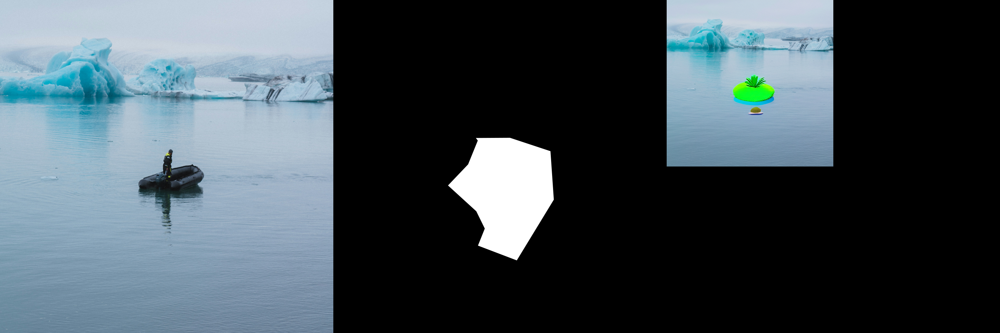

In [49]:
image = pipeline(prompt=prompt,
                 negative_prompt=negative_prompt,
                 image=init_image,
                 mask_image=mask_image,
                 generator=generator).images[0]

make_image_grid([init_image, mask_image, image], rows=1, cols=3)

In [50]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

####  Blurring the Mask Area

In [51]:
model_id = "runwayml/stable-diffusion-v1-5"

pipeline = AutoPipelineForInpainting.from_pretrained(
    model_id, torch_dtype=torch.float16
).to(device)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

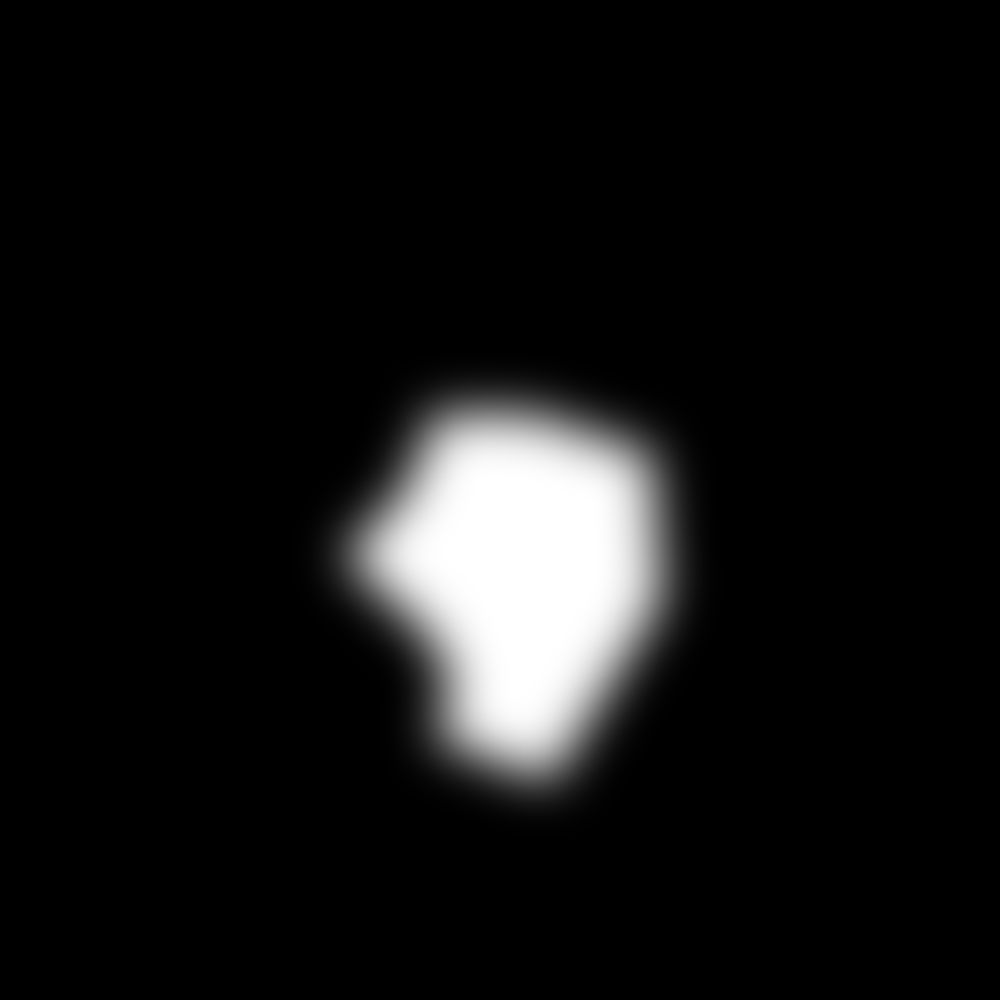

In [52]:
blurred_mask = pipeline.mask_processor.blur(mask_image, blur_factor=25)
blurred_mask

  0%|          | 0/50 [00:00<?, ?it/s]

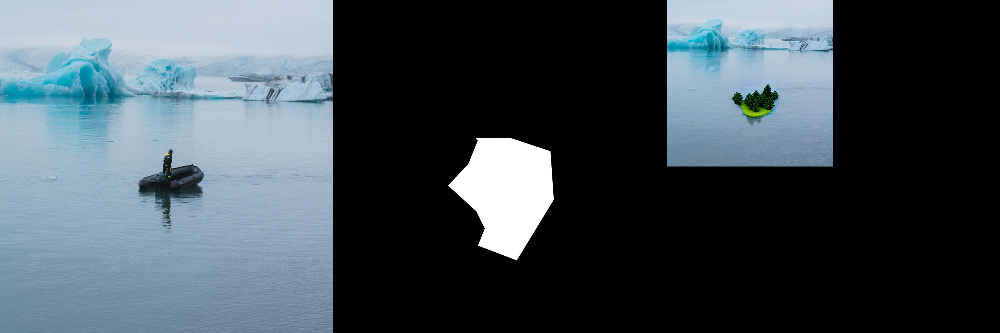

In [53]:
image = pipeline(prompt=prompt,
                 negative_prompt=negative_prompt,
                 image=init_image,
                 mask_image=blurred_mask,
                 generator=generator).images[0]

make_image_grid([init_image, mask_image, image], rows=1, cols=3)

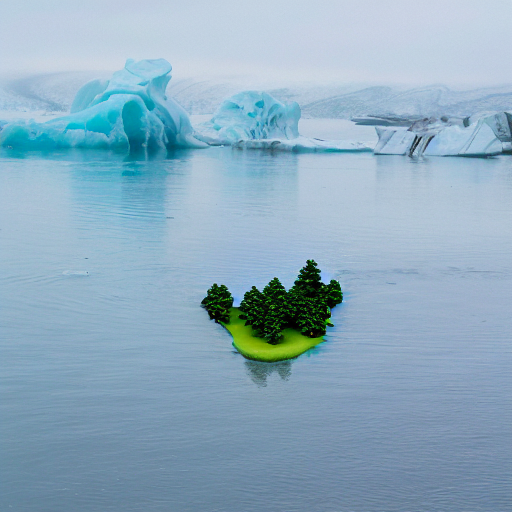

In [54]:
image

In [55]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

### SDXL for inpainting

In [61]:
pipeline = AutoPipelineForInpainting.from_pretrained(
    "diffusers/stable-diffusion-xl-1.0-inpainting-0.1", torch_dtype=torch.float16, variant="fp16"
).to(device)

prompt = "concept art of a small christmas tree in the middle of an ocean, horror, sinister, 8k"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'decay': 0.9999, 'inv_gamma': 1.0, 'min_decay': 0.0, 'optimization_step': 37000, 'power': 0.6666666666666666, 'update_after_step': 0, 'use_ema_warmup': False} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.


  0%|          | 0/49 [00:00<?, ?it/s]

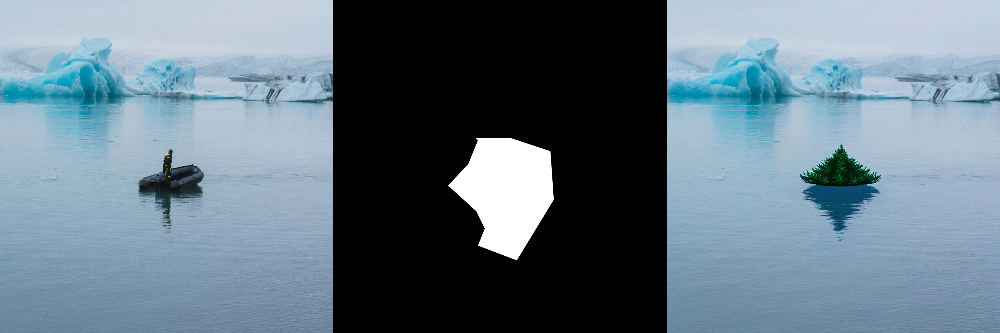

In [64]:
image = pipeline(prompt=prompt,
                 negative_prompt=negative_prompt,
                 image=init_image,
                 mask_image=mask_image,
                 generator=generator).images[0]

make_image_grid([init_image, mask_image, image], rows=1, cols=3)

  0%|          | 0/49 [00:00<?, ?it/s]

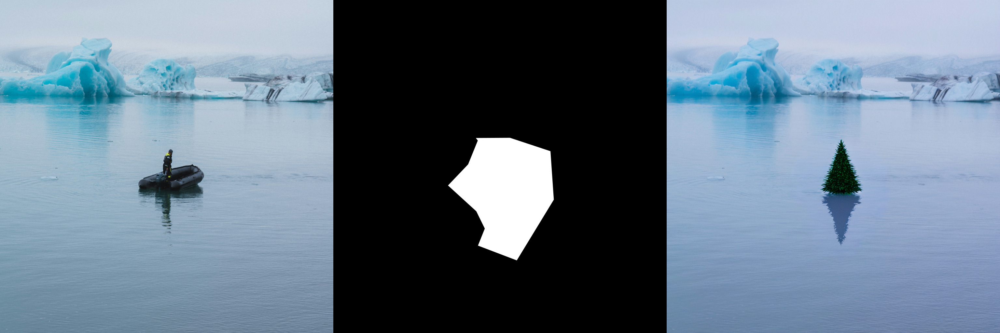

In [65]:
image = pipeline(prompt=prompt,
                 negative_prompt=negative_prompt,
                 image=init_image,
                 mask_image=pipeline.mask_processor.blur(mask_image, blur_factor=33),
                 generator=generator).images[0]

make_image_grid([init_image, mask_image, image], rows=1, cols=3)

In [66]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

### Preserving Unmasked Area

In [67]:
model_id = "runwayml/stable-diffusion-inpainting"
pipeline = AutoPipelineForInpainting.from_pretrained(
    "runwayml/stable-diffusion-inpainting",
    torch_dtype=torch.float16,
).to(device)

unet/diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [68]:
prompt = "concept art of a desolate ship, horror, sinister, 8k"
inpainted_image = pipeline(prompt=prompt,
                           image=init_image,
                           mask_image=mask_image).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

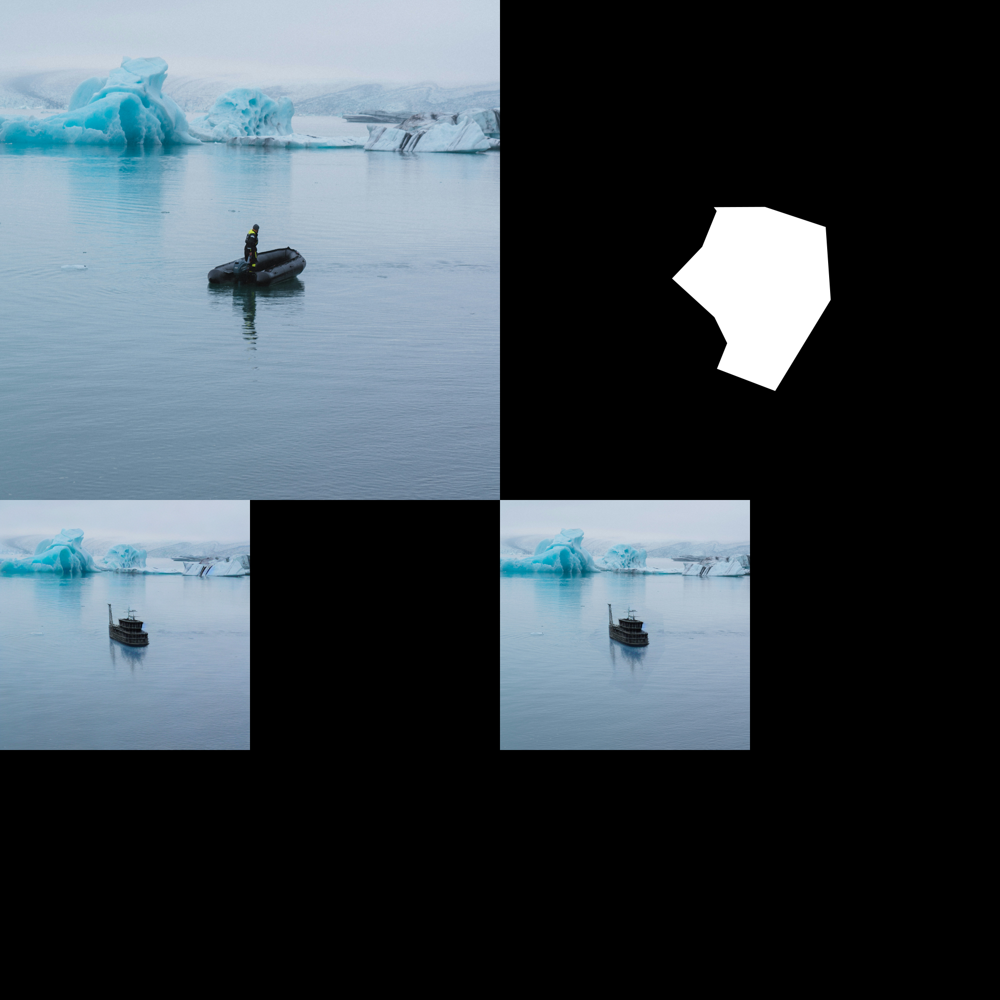

In [69]:
unmasked_unchanged_image = pipeline.image_processor.apply_overlay(mask_image,
                                                                  init_image,
                                                                  inpainted_image)
make_image_grid([init_image, mask_image, inpainted_image, unmasked_unchanged_image], rows=2, cols=2)

In [70]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

### Pipeline Parameters

- Strength
- Guidance Scale
- Negative Prompt
- Padding Mask Crop

In [71]:
model_id = "runwayml/stable-diffusion-inpainting"
pipeline = AutoPipelineForInpainting.from_pretrained(
    model_id, torch_dtype=torch.float16, variant="fp16"
).to(device)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [72]:
prompt = "a huge polar bear on the ocean, cute, adorable, pixar, disney, 8k"
negative_prompt = "bad anatomy, deformed, ugly, disfigured"

  0%|          | 0/45 [00:00<?, ?it/s]

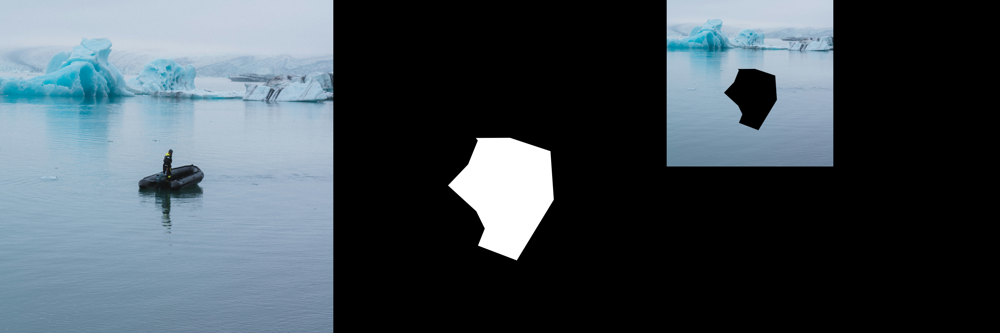

In [76]:
image = pipeline(prompt=prompt,
                 negative_prompt=negative_prompt,
                 image=init_image,
                 mask_image=mask_image,
                 strength=0.9,
                 guidance_scale=2.5,
                 padding_mask_crop=33).images[0]
make_image_grid([init_image, mask_image, image], rows=1, cols=3)

In [83]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

### Chained Inpainting

- Text2Image -> Inpainting

In [6]:
model_id = "stabilityai/stable-diffusion-2-1"
pipeline = AutoPipelineForText2Image.from_pretrained(
    model_id, torch_dtype=torch.float16, variant="fp16", use_safetensors=True
).to(device)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

In [7]:
prompt = "illustration of the hogwarts express going on the ocean, highly detailed, 8k"

  0%|          | 0/50 [00:00<?, ?it/s]

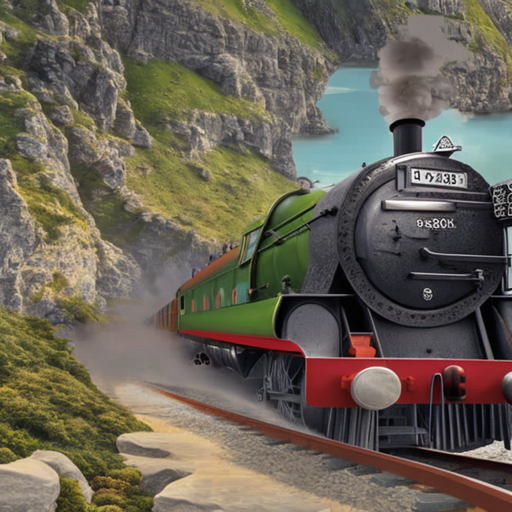

In [8]:
text2image = pipeline(prompt=prompt).images[0]
text2image.resize((512, 512))

In [9]:
# load an arbitrary image mask of 512X512
arbitrary_mask = load_image("https://huggingface.co/datasets/ritwikraha/random-storage/resolve/main/X4yzBR7%20-%20Imgur.png")

In [10]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

model_index.json:   0%|          | 0.00/257 [00:00<?, ?B/s]

Fetching 7 files:   0%|          | 0/7 [00:00<?, ?it/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/271M [00:00<?, ?B/s]

movq/config.json:   0%|          | 0.00/660 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/5.72k [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/318 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.67k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/5.01G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/3 [00:00<?, ?it/s]

model_index.json:   0%|          | 0.00/501 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

model.safetensors:   0%|          | 0.00/3.69G [00:00<?, ?B/s]

image_encoder/config.json:   0%|          | 0.00/2.01k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/4.10G [00:00<?, ?B/s]

image_processor/preprocessor_config.json:   0%|          | 0.00/315 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/229 [00:00<?, ?B/s]

prior/config.json:   0%|          | 0.00/252 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/2.02k [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/25 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

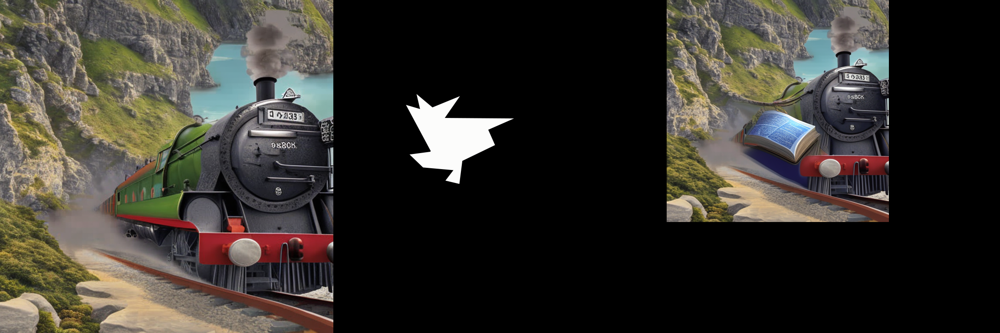

In [11]:
model_id = "kandinsky-community/kandinsky-2-2-decoder-inpaint"
pipeline = AutoPipelineForInpainting.from_pretrained(
    model_id, torch_dtype=torch.float16
).to(device)

prompt = "concept art of magical spells, illustrated, highly detailed, 8K "
image = pipeline(prompt=prompt,
                 image=text2image,
                 mask_image=arbitrary_mask).images[0]
make_image_grid([text2image, arbitrary_mask, image], rows=1, cols=3)

In [12]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

#### Inpainting to Image2Image

In [5]:
model_id = "runwayml/stable-diffusion-inpainting"
pipeline = AutoPipelineForInpainting.from_pretrained(
    model_id, torch_dtype=torch.float16, variant="fp16"
).to(device)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [6]:
prompt = "concept art of the fortress of doom, highly detailed, 8k"
negative_prompt = ""

In [7]:
image_inpainting = pipeline(prompt=prompt,
                            negative_prompt=negative_prompt,
                            image=init_image,
                            mask_image=mask_image).images[0]

# resize image to 1024x1024 for SDXL
image_inpainting = image_inpainting.resize((1024, 1024))

  0%|          | 0/50 [00:00<?, ?it/s]

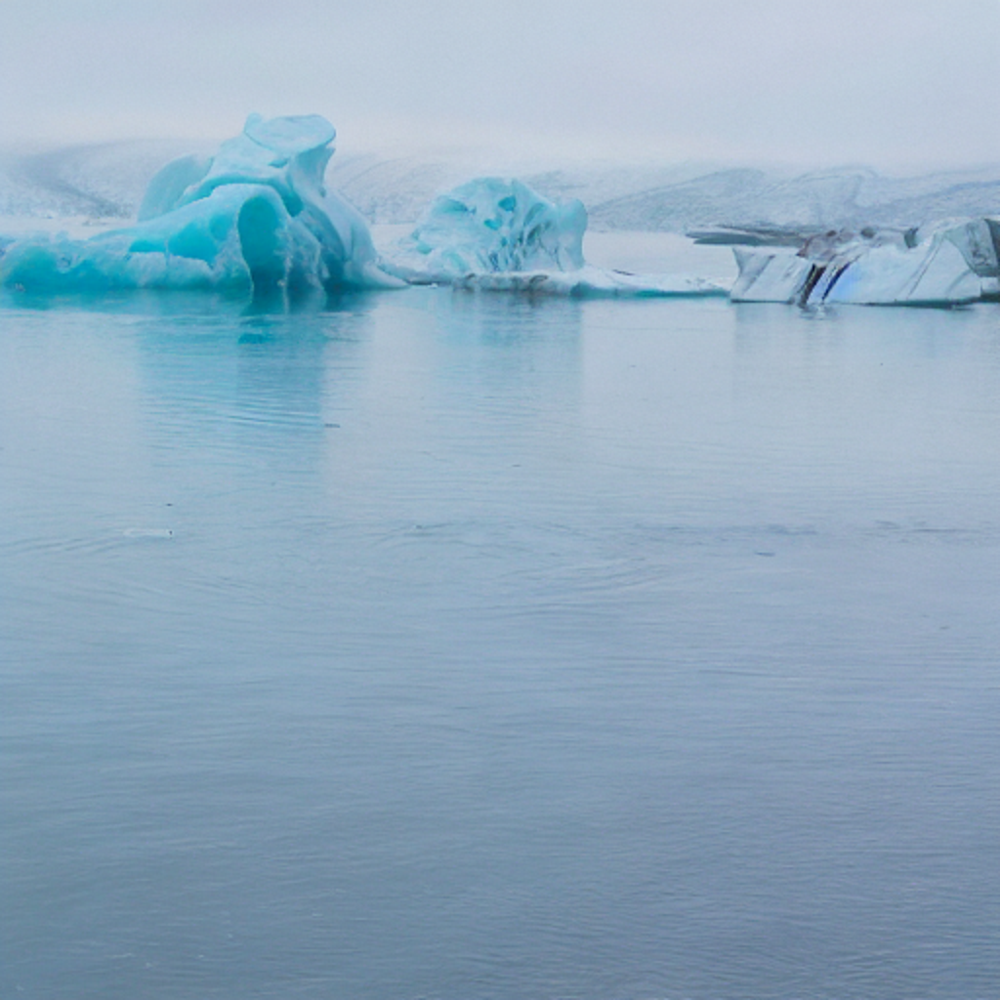

In [8]:
image_inpainting

In [9]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

In [16]:
model_id = "stabilityai/stable-diffusion-xl-refiner-1.0"
pipeline = AutoPipelineForInpainting.from_pretrained(
    model_id, torch_dtype=torch.float16, variant="fp16"
).to(device)

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

In [17]:
image = pipeline(prompt=prompt,
                 image=image_inpainting,
                 mask_image=mask_image,
                 output_type="latent").images[0]

  0%|          | 0/49 [00:00<?, ?it/s]

In [18]:
pipeline = AutoPipelineForImage2Image.from_pipe(pipeline).to(device)

  0%|          | 0/15 [00:00<?, ?it/s]

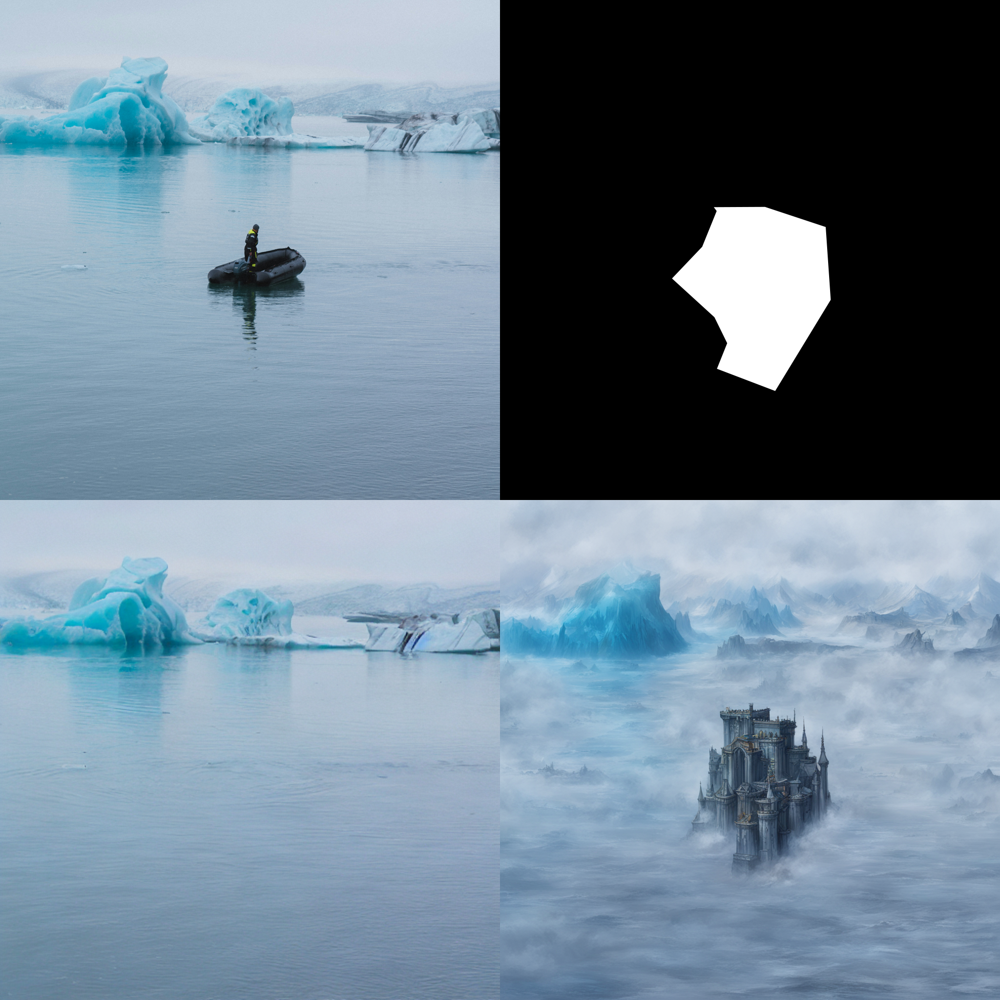

In [19]:
image = pipeline(prompt=prompt, image=image).images[0]
make_image_grid([init_image, mask_image, image_inpainting, image], rows=2, cols=2)

In [20]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

### Controlling Image Generation


- ControlNet


In [21]:
controlnet_model_id = "lllyasviel/control_v11p_sd15_inpaint"
sd_model_id = "runwayml/stable-diffusion-inpainting"

# load ControlNet
controlnet = ControlNetModel.from_pretrained(controlnet_model_id,
                                             torch_dtype=torch.float16,
                                             variant="fp16").to(device)

# pass ControlNet to the pipeline
pipeline = StableDiffusionControlNetInpaintPipeline.from_pretrained(
    sd_model_id,
    controlnet=controlnet,
    torch_dtype=torch.float16,
    variant="fp16"
).to(device)


config.json:   0%|          | 0.00/998 [00:00<?, ?B/s]

diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/723M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [22]:
# prepare control image
def make_inpaint_condition(init_image, mask_image):
    init_image = np.array(init_image.convert("RGB")).astype(np.float32) / 255.0
    mask_image = np.array(mask_image.convert("L")).astype(np.float32) / 255.0

    assert init_image.shape[0:1] == mask_image.shape[0:1], "image and image_mask must have the same image size"
    init_image[mask_image > 0.5] = -1.0  # set as masked pixel
    init_image = np.expand_dims(init_image, 0).transpose(0, 3, 1, 2)
    init_image = torch.from_numpy(init_image)
    return init_image

In [23]:
control_image = make_inpaint_condition(init_image, mask_image)
control_image

tensor([[[[0.7294, 0.7373, 0.7294,  ..., 0.7686, 0.7765, 0.7686],
          [0.7255, 0.7333, 0.7294,  ..., 0.7686, 0.7647, 0.7490],
          [0.7294, 0.7294, 0.7255,  ..., 0.7647, 0.7647, 0.7569],
          ...,
          [0.3843, 0.3961, 0.3961,  ..., 0.4118, 0.4078, 0.4039],
          [0.3882, 0.3882, 0.4039,  ..., 0.4118, 0.4118, 0.4039],
          [0.4000, 0.3961, 0.4118,  ..., 0.4118, 0.4118, 0.4078]],

         [[0.8000, 0.8078, 0.8000,  ..., 0.8235, 0.8314, 0.8235],
          [0.7961, 0.8039, 0.8000,  ..., 0.8235, 0.8196, 0.8039],
          [0.8000, 0.8000, 0.7961,  ..., 0.8196, 0.8196, 0.8118],
          ...,
          [0.5137, 0.5255, 0.5255,  ..., 0.4980, 0.4941, 0.4902],
          [0.5176, 0.5176, 0.5255,  ..., 0.4980, 0.4980, 0.4902],
          [0.5255, 0.5176, 0.5255,  ..., 0.4980, 0.4980, 0.4941]],

         [[0.8549, 0.8627, 0.8549,  ..., 0.8745, 0.8824, 0.8745],
          [0.8510, 0.8588, 0.8549,  ..., 0.8745, 0.8706, 0.8549],
          [0.8549, 0.8549, 0.8510,  ..., 0

  0%|          | 0/50 [00:00<?, ?it/s]

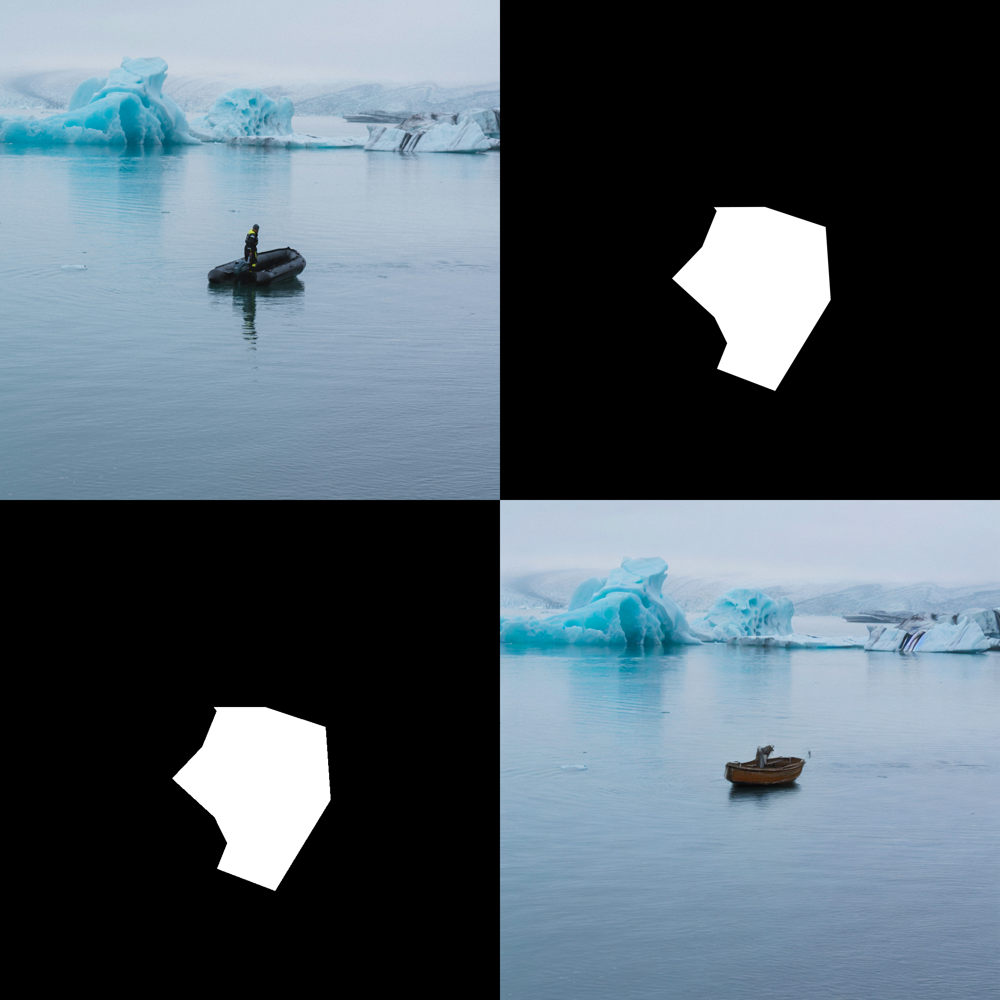

In [24]:
prompt = "concept art of a small haunted boat, stephen king, horror, sinister, 8k"
image = pipeline(prompt=prompt, image=init_image, mask_image=mask_image, control_image=control_image).images[0]
make_image_grid([init_image, mask_image, Image.fromarray(np.uint8(control_image[0][0])).convert('RGB'), image], rows=2, cols=2)

In [ ]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/15 [00:00<?, ?it/s]

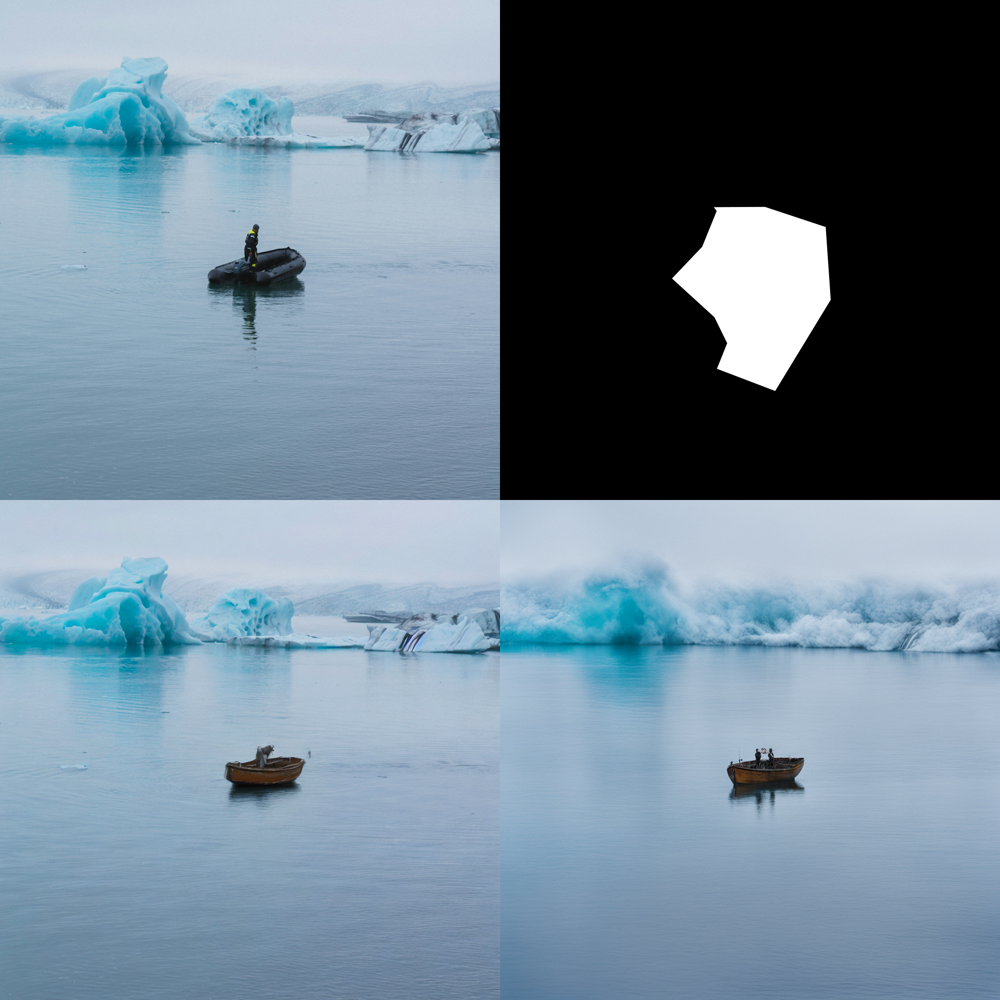

In [25]:
model_id = "stabilityai/stable-diffusion-xl-refiner-1.0"
pipeline = AutoPipelineForImage2Image.from_pretrained(
    model_id, torch_dtype=torch.float16,
).to(device)

prompt = "zack snyder style"
negative_prompt = "bad architecture, deformed, disfigured, poor details"

image_elden_ring = pipeline(prompt, negative_prompt=negative_prompt, image=image).images[0]
make_image_grid([init_image, mask_image, image, image_elden_ring], rows=2, cols=2)

In [26]:
pipeline.to("cpu")
del pipeline
torch.cuda.empty_cache()

Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, due to the lack of support for`float16` operations on this device in PyTorch. Please, remove the `torch_dtype=torch.float16` argument, or use another device for inference.
Pipelines loaded with `dtype=torch.float16` cannot run with `cpu` device. It is not recommended to move them to `cpu` as running them will fail. Please make sure to use an accelerator to run the pipeline in inference, du

## Mask Generation


Draw masks the old-fashioned way:


https://huggingface.co/spaces/ritwikraha/simple-mask-maker

In [31]:
generator = pipeline("mask-generation", model="Zigeng/SlimSAM-uniform-50", points_per_batch=64, device="cuda")
image_url = "https://huggingface.co/datasets/ritwikraha/random-storage/resolve/main/boat.png"
outputs = generator(image_url)
outputs["masks"]
# array of multiple binary masks returned for each generated mask

[array([[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]]),
 array([[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False]]),
 array([[False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, False, False],
        ...,
        [False, False, False, ..., False, False, False],
        [False, False, False, ..., False, Fal

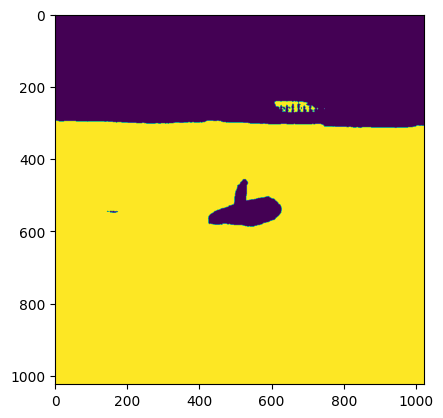

In [32]:
plt.imshow(outputs["masks"][0])